In [1]:
import pandas as pd
from tensorflow.keras.layers import Embedding
from tensorflow.keras.models import Sequential
import tensorflow as tf
import numpy as np
import re
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize, RegexpTokenizer
from nltk.stem import SnowballStemmer

In [2]:
### Descargar stopwords
nltk.download('stopwords')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\USER\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\USER\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

##### Cargue datos

In [3]:
Df = pd.read_csv("C:/Users/USER/OneDrive - universidadean.edu.co/5. NLP/Repositorio NLP/Actividad 1/reviews_booking.csv")
Df['Calificación'] = Df['Calificación'].astype(str).str.replace(',', '.').astype(float)
Df = Df.drop("Unnamed: 0", axis=1)
Df

C:\Users\Public\Documents\Wondershare\CreatorTemp\ipykernel_24776\2155560498.py:1: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  Df = pd.read_csv("C:/Users/USER/OneDrive - universidadean.edu.co/5. NLP/Repositorio NLP/Actividad 1/reviews_booking.csv")


,País,Acomodación,Noches,Fecha hospedaje,Grupo viaje,Fecha reseña,Titulo,Calificación,Cosas Positivas,Cosas Negativas,reseña
0,Venezuela,NaN,2 noches,julio de 2023,En pareja,31 de julio de 2023,Excepcional,10.0,Fue la Mejor Opción que pudimos haber tomado e...,NaN,Sí
1,Colombia,NaN,4 noches,octubre de 2024,Persona que viaja sola,23 de octubre de 2024,Fantástica,10.0,"Ubicación, comodidades y limpieza",NaN,Sí
2,Colombia,NaN,1 noche,octubre de 2024,Persona que viaja sola,15 de octubre de 2024,Excepcional,10.0,"El lugar esta muy bien ubicado, el apartamento...",NaN,Sí
3,Colombia,NaN,1 noche,agosto de 2024,En pareja,20 de agosto de 2024,Gran apartamento en una gran ubicación.,10.0,Todo estuvo perfecto. La ubicación y la relaci...,NaN,Sí
4,Colombia,NaN,3 noches,marzo de 2024,En pareja,27 de marzo de 2024,Excepcional,10.0,"Es muy cómodo y acogedor, la atención es excel...",NaN,Sí
...,...,...,...,...,...,...,...,...,...,...,...
438208,Estados Unidos,Apartamento Suite,1 noche,septiembre de 2024,En familia,22 de octubre de 2024,Fantástico,9.0,NaN,NaN,No
438209,Colombia,Apartamento de 1 dormitorio,1 noche,octubre de 2024,Persona que viaja sola,9 de octubre de 2024,Excepcional,10.0,NaN,NaN,No
438210,México,Apartamento de 1 dormitorio,4 noches,agosto de 2024,Persona que viaja sola,6 de septiembre de 2024,Pésimo,1.0,No me pareció nada,No obstante que dos días antes de mi llegada a...,Sí
438211,Colombia,Apartamento de 1 dormitorio,2 noches,julio de 2024,En pareja,22 de julio de 2024,Excepcional,10.0,NaN,NaN,No


Corpus Cosas positivas

In [4]:
    # Crear una lista de stopwords
    stop_words = set(stopwords.words('spanish'))

    #Función para contar stopwords en un texto
    def count_stopwords(text):
        if not isinstance(text, str):
            return 0
        words = text.split()
        return sum(1 for word in words if word.lower() in stop_words)

    # Contar stopwords en la columna 'Cosas Positivas'
    stopword_counts = Df['Cosas Positivas'].apply(count_stopwords)

    # Filtrar filas con menos de 5 stopwords
    Corpus_positivo = Df[stopword_counts >= 15]

    # Filtrar filas donde 'Cosas Positivas' tenga más de #### palabra
    Corpus_positivo = Corpus_positivo[Corpus_positivo['Cosas Positivas'].str.split().str.len() > 30]

    # Filtrar filas donde 'Calificación' sea mayor a 9
    Corpus_positivo = Corpus_positivo[Corpus_positivo['Calificación'] > 9]

    Corpus_positivo

,País,Acomodación,Noches,Fecha hospedaje,Grupo viaje,Fecha reseña,Titulo,Calificación,Cosas Positivas,Cosas Negativas,reseña
0,Venezuela,NaN,2 noches,julio de 2023,En pareja,31 de julio de 2023,Excepcional,10.0,Fue la Mejor Opción que pudimos haber tomado e...,NaN,Sí
17,Ecuador,NaN,5 noches,octubre de 2024,Persona que viaja sola,29 de octubre de 2024,Excepcional,10.0,Me gusto Poder comprar los alimentos a mi gust...,NaN,Sí
70,Colombia,NaN,1 noche,agosto de 2022,En familia,9 de agosto de 2022,"Maravilloso alojamiento, recomendado!",10.0,"La calidad de personas es maravilloso, desde q...",NaN,Sí
476,Ecuador,NaN,1 noche,agosto de 2024,Persona que viaja sola,26 de agosto de 2024,Excepcional,10.0,La atención como me recibieron es muy buena po...,NaN,Sí
485,Colombia,NaN,2 noches,junio de 2024,En familia,4 de julio de 2024,Un hotel muy agradable,10.0,"El hotel es muy acogedor, está ubicado en una ...",La verdad no hubo nada que no me haya gustado.,Sí
...,...,...,...,...,...,...,...,...,...,...,...
438075,Colombia,Apartamento de 1 dormitorio,5 noches,noviembre de 2024,Persona que viaja sola,10 de noviembre de 2024,Súper,10.0,"El apartamento tiene vista muy bonita, puedes ...",NaN,Sí
438081,Colombia,Habitación Individual,1 noche,junio de 2024,Persona que viaja sola,2 de junio de 2024,Excelente y buen precio,10.0,El mejor hotel boutique en el que me he quedad...,Todo estuvo muy bien.,Sí
438083,Colombia,Habitación Individual,1 noche,junio de 2024,Persona que viaja sola,2 de junio de 2024,Confortable y Conveniente,10.0,"El personal fue amable y atento, la habitación...",NaN,Sí
438170,Colombia,Apartamento de 1 dormitorio,11 noches,julio de 2024,En familia,5 de agosto de 2024,Excelente,10.0,Excelente ubicación con muchos museos y zonas ...,NaN,Sí


##### Preprocesamiento

Normalizacion y tokenizacion

In [5]:
def preprocesar(texto):
    # Convertir a minúsculas
    texto = texto.lower()
    # Eliminar caracteres no alfabéticos y números
    texto = re.sub(r"[\W\d_]+", " ", texto)
    # Crear el tokenizador con expresión regular para palabras
    tokenizer = RegexpTokenizer(r'\w+')
    # Tokenizar el texto y devolverlo como una lista de palabras
    tokens = tokenizer.tokenize(texto)
    return tokens

# Aplicar preprocesamiento a la columna 'Cosas Positivas'
Corpus_positivo = [preprocesar(texto) for texto in Corpus_positivo['Cosas Positivas']]
Corpus_positivo


[['fue',
  'la',
  'mejor',
  'opción',
  'que',
  'pudimos',
  'haber',
  'tomado',
  'en',
  'bogotá',
  'lo',
  'recomendamos',
  'mil',
  'al',
  'regresar',
  'sin',
  'duda',
  'contactaremos',
  'al',
  'anfitrión',
  'porque',
  'fue',
  'todo',
  'un',
  'encanto',
  'limpio',
  'cómodo',
  'cercano',
  'a',
  'todo',
  'súper',
  'seguro',
  'fue',
  'increíble',
  'nuestra',
  'estancia'],
 ['me',
  'gusto',
  'poder',
  'comprar',
  'los',
  'alimentos',
  'a',
  'mi',
  'gusto',
  'ya',
  'que',
  'cuentan',
  'con',
  'lo',
  'basico',
  'como',
  'cocina',
  'nevera',
  'microondas',
  'esta',
  'muy',
  'equipado',
  'el',
  'lugar',
  'es',
  'cómodo',
  'esta',
  'cerca',
  'de',
  'un',
  'centro',
  'comercial',
  'y',
  'cerca',
  'de',
  'la',
  'embajada',
  'de',
  'mexico',
  'me',
  'parecio',
  'perfecto',
  'para',
  'poder',
  'realizar',
  'mis',
  'tramites',
  'la',
  'estadía',
  'es',
  'muy',
  'tranquila',
  'la',
  'recomiendo',
  'esta',
  'ubicado

In [6]:
# Crear un conjunto único de palabras en el corpus
vocab = set(word for sentence in Corpus_positivo for word in sentence)

# Crear un diccionario para mapear palabras a índices
word2idx = {word: idx + 1 for idx, word in enumerate(vocab)}

# Crear un diccionario inverso para mapear índices a palabras
idx2word = {idx: word for word, idx in word2idx.items()}

# Tamaño del vocabulario
vocab_size = len(word2idx)
print(f"Tamaño del vocabulario: {vocab_size}")

# Mostrar el diccionario índice a palabra
idx2word



Tamaño del vocabulario: 13609


{1: 'aucun',
 2: 'garantizada',
 3: 'peatonal',
 4: 'predio',
 5: 'volumen',
 6: 'als',
 7: 'transportan',
 8: 'permanent',
 9: 'biblioteca',
 10: 'moverte',
 11: 'che',
 12: 'sereinement',
 13: 'payer',
 14: 'puso',
 15: 'aconsejaron',
 16: 'dudaría',
 17: 'chaval',
 18: 'martin',
 19: 'molestan',
 20: 'fantastische',
 21: 'xx',
 22: 'ariza',
 23: 'dueños',
 24: 'pessoa',
 25: 'probe',
 26: 'sigue',
 27: 'estática',
 28: 'secadora',
 29: 'hablas',
 30: 'recibimiento',
 31: 'ojala',
 32: 'pm',
 33: 'movilizarte',
 34: 'dilbert',
 35: 'complacernos',
 36: 'inmediata',
 37: 'americano',
 38: 'creadas',
 39: 'abundancia',
 40: 'modernos',
 41: 'choro',
 42: 'enviarían',
 43: 'condicionador',
 44: 'entonces',
 45: 'despertaran',
 46: 'asientos',
 47: 'preciosidad',
 48: 'pernoctamos',
 49: 'sandwiches',
 50: 'estudio',
 51: 'calentita',
 52: 'idílico',
 53: 'arrangeant',
 54: 'brinde',
 55: 'gut',
 56: 'quieto',
 57: 'bacano',
 58: 'fond',
 59: 'importa',
 60: 'gros',
 61: 'protector',
 62

In [7]:
def generate_context(corpus, window_size):
    context_length = 2 * window_size  # Longitud del contexto total
    for words in corpus:
        sentence_length = len(words)  # Longitud de la oración
        for index, word in enumerate(words):
            context_words = []
            start = index - window_size  # Inicio de la ventana
            end = index + window_size + 1  # Fin de la ventana
            # Obtener índices de palabras en el contexto
            context_words.append([word2idx[words[i]]
                                  for i in range(start, end)
                                  if 0 <= i < sentence_length and i != index])
            target_word = word2idx[word]  # Índice de la palabra objetivo
            yield (context_words[0], target_word)  # Devolver contexto y objetivo

# Configurar el tamaño de la ventana
window_size = 4
# Generar los datos de contexto
data = list(generate_context(Corpus_positivo[:3], window_size))
# Mostrar un ejemplo específico
data[3]


([10452, 12966, 1264, 10355, 3378, 4659, 10324], 3017)

In [8]:
print(idx2word[8398])
print(idx2word[11287])
print(idx2word[3541])
print(idx2word[4880])
print(idx2word[11708])
print(idx2word[4651])
print(idx2word[2492])
print("Palabra clave:",idx2word[6335])

bains
colada
indian
esencias
funcionar
ps
maravillosas
Palabra clave: calientito


In [9]:
X,y=zip(*data)

In [10]:
X=tf.keras.preprocessing.sequence.pad_sequences(X)

# Aumentar el número de columnas que se imprimen
np.set_printoptions(threshold=np.inf, linewidth=np.inf)
print(X)

[[    0     0     0     0 12966  1264  3017 10355]
 [    0     0     0 10452  1264  3017 10355  3378]
 [    0     0 10452 12966  3017 10355  3378  4659]
 [    0 10452 12966  1264 10355  3378  4659 10324]
 [10452 12966  1264  3017  3378  4659 10324   896]
 [12966  1264  3017 10355  4659 10324   896  2011]
 [ 1264  3017 10355  3378 10324   896  2011 10995]
 [ 3017 10355  3378  4659   896  2011 10995  5468]
 [10355  3378  4659 10324  2011 10995  5468  5728]
 [ 3378  4659 10324   896 10995  5468  5728  2759]
 [ 4659 10324   896  2011  5468  5728  2759 10145]
 [10324   896  2011 10995  5728  2759 10145  1156]
 [  896  2011 10995  5468  2759 10145  1156   792]
 [ 2011 10995  5468  5728 10145  1156   792  3899]
 [10995  5468  5728  2759  1156   792  3899  2759]
 [ 5468  5728  2759 10145   792  3899  2759  3927]
 [ 5728  2759 10145  1156  3899  2759  3927  7025]
 [ 2759 10145  1156   792  2759  3927  7025 10452]
 [10145  1156   792  3899  3927  7025 10452  7645]
 [ 1156   792  3899  2759  7025

In [11]:
print(idx2word[8398])


bains


In [12]:
# Definir el tamaño del vocabulario y la dimensión de las capas densas
vocab_size = len(vocab)  # Número total de palabras únicas en el vocabulario
dimen_densa = 120        # Raiz del Tamaño del vocabulario

# Definir la entrada del modelo
inputs = tf.keras.Input(shape=(window_size * 2,), dtype=tf.int32)
# La entrada será una secuencia de enteros de longitud `window_size*2` (palabras en contexto).

# Capa de embeddings (W)
embedding = tf.keras.layers.Embedding(
    input_dim=vocab_size + 1,   # Tamaño del vocabulario (+1 por si hay padding)
    output_dim=dimen_densa,    # Dimensión de los vectores de embedding
    input_length=window_size * 2  # Longitud de la entrada (contexto)
)(inputs)
# Transforma cada entero (palabra) en un vector denso de dimensión `dimen_densa`.

# Promediar los vectores del embedding (reduce_mean)
mean_embedding = tf.keras.layers.Lambda(lambda x: tf.reduce_mean(x, axis=1))(embedding)
# Calcula el promedio de los vectores de embedding a lo largo de las palabras en el contexto.
# Esto genera un único vector que resume toda la secuencia de entrada.

# Capa de salida (U)
outputs = tf.keras.layers.Dense(
    vocab_size + 1,  # Número de neuronas igual al tamaño del vocabulario (+1)
    activation='softmax'  # Activación softmax para obtener probabilidades
)(mean_embedding)
# Predice la probabilidad de cada palabra del vocabulario (dada la entrada promedio).

# Crear el modelo
model = tf.keras.Model(inputs=inputs, outputs=outputs)
# Define el modelo con las entradas y las salidas especificadas.

# Compilar el modelo
model.compile(
    optimizer='adam',  # Optimizador Adam (común para NLP y redes neuronales)
    loss='sparse_categorical_crossentropy'  # Pérdida categórica para clasificación
)
# Configura el modelo para entrenar, utilizando la función de pérdida y el optimizador.

# Mostrar un resumen del modelo
model.summary()
# Muestra la estructura del modelo, incluyendo el número de capas y parámetros.



c:\Users\USER\miniconda3\envs\entorno_npl_ean_py3.10\lib\site-packages\keras\src\layers\core\embedding.py:90: UserWarning: Argument `input_length` is deprecated. Just remove it.
  warnings.warn(


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 8)              │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ embedding (Embedding)           │ (None, 8, 120)         │     1,633,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lambda (Lambda)                 │ (None, 120)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 13610)          │     1,646,810 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,280,010 (12.51 MB)

 Trainable params: 3,280,010 (12.51 MB)

 Non-trainable params: 0 (0.00 B)

In [13]:
model.fit(np.array(X),np.array(y),epochs=100, verbose=2)

Epoch 1/100
6/6 - 1s - 234ms/step - loss: 9.5174
Epoch 2/100
6/6 - 0s - 29ms/step - loss: 9.5039
Epoch 3/100
6/6 - 0s - 28ms/step - loss: 9.4900
Epoch 4/100
6/6 - 0s - 28ms/step - loss: 9.4732
Epoch 5/100
6/6 - 0s - 28ms/step - loss: 9.4511
Epoch 6/100
6/6 - 0s - 28ms/step - loss: 9.4199
Epoch 7/100
6/6 - 0s - 29ms/step - loss: 9.3755
Epoch 8/100
6/6 - 0s - 27ms/step - loss: 9.3113
Epoch 9/100
6/6 - 0s - 27ms/step - loss: 9.2217
Epoch 10/100
6/6 - 0s - 26ms/step - loss: 9.1010
Epoch 11/100
6/6 - 0s - 27ms/step - loss: 8.9394
Epoch 12/100
6/6 - 0s - 28ms/step - loss: 8.7374
Epoch 13/100
6/6 - 0s - 28ms/step - loss: 8.4854
Epoch 14/100
6/6 - 0s - 27ms/step - loss: 8.1863
Epoch 15/100
6/6 - 0s - 27ms/step - loss: 7.8325
Epoch 16/100
6/6 - 0s - 27ms/step - loss: 7.4309
Epoch 17/100
6/6 - 0s - 27ms/step - loss: 6.9855
Epoch 18/100
6/6 - 0s - 25ms/step - loss: 6.5131
Epoch 19/100
6/6 - 0s - 27ms/step - loss: 6.0442
Epoch 20/100
6/6 - 0s - 27ms/step - loss: 5.6187
Epoch 21/100
6/6 - 0s - 27ms

In [15]:
word_vectors = model.get_layer('embedding').get_weights()[0]
word_vectors


array([[ 4.53805596e-01, -1.15346336e+00,  6.46159351e-01,  2.25884795e-01, -5.73187709e-01,  1.50380470e-02, -5.55078566e-01,  9.25710499e-01, -7.17558861e-01, -8.45629632e-01, -8.77561271e-01, -1.53743279e+00, -6.97058201e-01, -1.15628138e-01,  1.18426955e+00, -5.99770904e-01,  4.89124388e-01,  7.99508452e-01, -6.90804943e-02, -6.55948341e-01, -4.23635989e-01,  7.64287412e-01,  8.95599008e-01, -1.32772183e+00, -7.46438503e-01, -8.04692447e-01,  6.15414262e-01,  5.66968024e-01, -7.93555498e-01, -3.55360687e-01,  1.19475031e+00,  7.46581018e-01, -5.91425061e-01,  4.05677587e-01,  1.00251698e+00, -8.77714753e-01, -7.66004503e-01,  7.97648668e-01, -7.91522443e-01,  6.12266421e-01, -6.53118432e-01,  1.62262475e+00,  5.02710462e-01,  7.87634432e-01, -1.24318004e+00, -8.26509595e-01, -3.73096287e-01, -6.86334968e-01, -8.85243773e-01, -5.71892858e-01,  5.96454203e-01, -7.04798028e-02,  6.65632784e-01, -6.24086678e-01, -4.20429617e-01, -5.65391541e-01,  6.87986672e-01,  4.31958795e-01, -6.236

In [16]:
# Importar bibliotecas necesarias
import numpy as np
from sklearn.decomposition import PCA
from sklearn.metrics.pairwise import cosine_similarity
import matplotlib.pyplot as plt
from wordcloud import WordCloud

In [17]:
# Función para encontrar palabras similares
def find_similar_words(target_word, word_vectors, vocab, top_n=5):
    if target_word not in vocab:
        print(f"La palabra '{target_word}' no está en el vocabulario.")
        return []
    
    target_index = vocab[target_word]
    target_vector = word_vectors[target_index]
    similarities = cosine_similarity([target_vector], word_vectors)[0]
    similar_indices = np.argsort(similarities)[::-1][1:top_n + 1]
    
    similar_words = [idx2word[idx] for idx in similar_indices if idx in idx2word]
    return similar_words

In [18]:
# Palabras similares a "habitacion", "hotel" y "excelente"
similar_to_habitacion = find_similar_words("habitación", word_vectors, vocab, top_n=10)
similar_to_hotel = find_similar_words("hotel", word_vectors, vocab, top_n=8)
similar_to_excelente = find_similar_words("excelente", word_vectors, vocab, top_n=8)

# Mostrar resultados de palabras similares
print("Palabras similares a 'habitacion':", similar_to_habitacion)
print("Palabras similares a 'hotel':", similar_to_hotel)
print("Palabras similares a 'excelente':", similar_to_excelente)

TypeError: 'set' object is not subscriptable

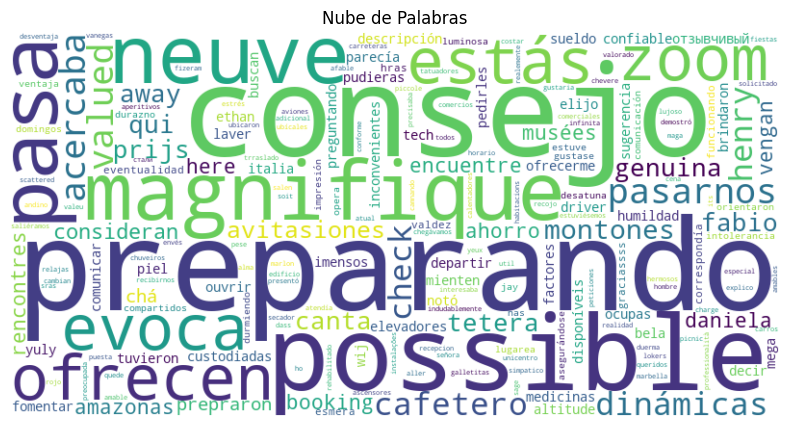

In [ ]:
# Generar nube de palabras
word_freq = {word: 1 for word in vocab}  # Frecuencia uniforme para simplificar
wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_freq)
# Graficar nube de palabras
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.title("Nube de Palabras")
plt.show()

AttributeError: 'set' object has no attribute 'items'

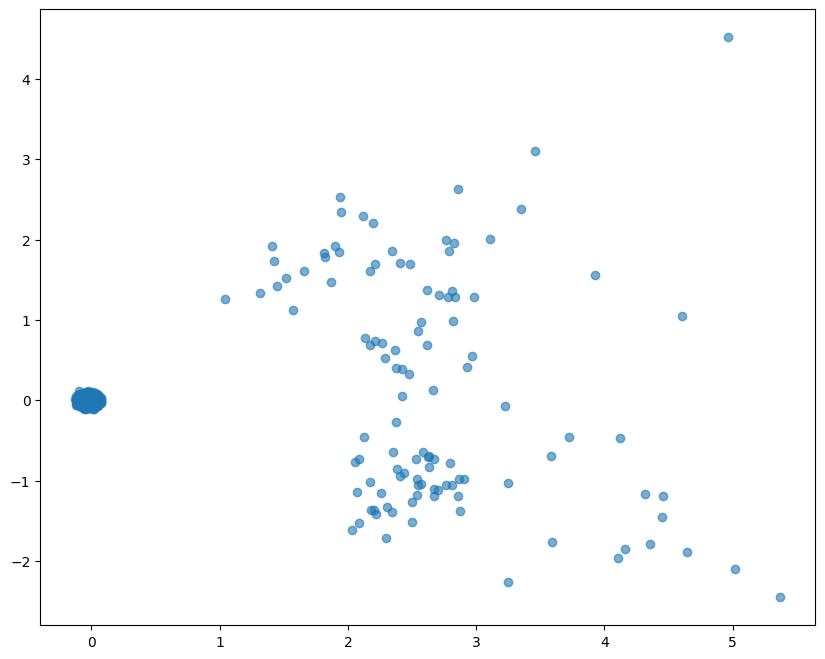

In [ ]:
# Graficar con PCA
pca = PCA(n_components=2)
word_vectors_reduced = pca.fit_transform(word_vectors)  # Reducir a dos dimensiones

plt.figure(figsize=(10, 8))
plt.scatter(word_vectors_reduced[:, 0], word_vectors_reduced[:, 1], alpha=0.6)
for word, index in vocab.items():  # Etiquetar palabras
    plt.text(word_vectors_reduced[index, 0], word_vectors_reduced[index, 1], word, fontsize=9)
plt.title("Visualización de Vectores de Palabras (PCA)")
plt.xlabel("Componente Principal 1")
plt.ylabel("Componente Principal 2")
plt.show()

#### Preguntas

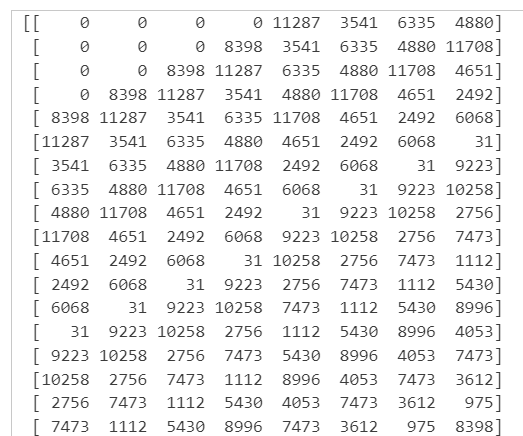

Observacion extrañan de patrones
Como le hago entender que es positivo o negativos
Solcuionar errores de las resultados